## Check on urban-specific urban signals

Author: Yifan Cheng

In [3]:
import datetime
current_time = datetime.datetime.now().strftime("%Y-%m-%d %H:%M")
print(f'Last updated at {current_time}')

Last updated at 2025-05-16 09:51


In [2]:
import geopandas as gpd
from shapely.geometry import Point
import numpy as np
import hvplot
from pathlib import Path 
import xarray as xr
import cartopy.crs as ccrs
import uxarray as ux
import cartopy.feature as cf
import matplotlib.pyplot as plt
import pandas as pd

In [16]:
import intake

cat_url = "https://digital-earths-global-hackathon.github.io/catalog/catalog.yaml"
cat = intake.open_catalog(cat_url).NCAR

# check on global models
model_run1 = cat['icon_d3hp003']
model_run2 = cat['ifs_tco3999-ng5_deepoff']
model_run3 = cat['nicam_gl11']
model_run4 = cat['mpas_dyamond3']
model_run5 = cat['mpas_dyamond2']
model_run6 = cat['scream_ne120'] #3hourly average
model_run7 = cat['wrf_conus']

In [9]:
model_run5.describe()['user_parameters']

[{'name': 'time',
  'description': 'temporal resolution of the dataset',
  'type': 'str',
  'allowed': ['PT3H'],
  'default': 'PT3H'},
 {'name': 'zoom',
  'description': 'zoom resolution of the dataset',
  'type': 'int',
  'allowed': [10, 9, 8, 7, 6, 5, 4, 3, 2, 1],
  'default': 7}]

In [17]:
ds_fine5 = model_run5(zoom=10,time='PT3H').to_dask()

/glade/work/yifanc17/miniconda3/envs/hackathon_env/lib/python3.12/site-packages/intake_xarray/base.py:21: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  'dims': dict(self._ds.dims),


In [18]:
uxds_fine5 = ux.UxDataset.from_healpix(ds_fine5)

In [8]:
land_mask=ux.UxDataArray((uxds_fine5.vegfra.isel(time=0)!=0).astype(int),uxgrid=uxds_fine5.uxgrid)

In [19]:
%%time
uxds_fine5_skintemp=uxds_fine5.skintemp

CPU times: user 29.7 ms, sys: 60 ms, total: 89.7 ms
Wall time: 87.6 ms


In [5]:
# Chicago, IL
chi_bounds = (41.6 - 1.5, 42.1 + 1.5), (-88.0 - 1.5, -87.5 + 1.5)
# Phoenix, AZ
phx_bounds = (33.2 - 1, 33.7 + 1), (-112.3 - 1, -111.8 + 1)
# Denver, CO
dnv_bounds = (39.5 - 0.5, 40.1 + 0.5), (-105.2 - 0.5, -104.5 + 0.5)
# Los Angeles, CA
lax_bounds = (33.7 - 1.5, 34.3 + 1.5), (-118.7 - 1.5, -118.0 + 1.5)
# Portland, OR
por_bounds = (45.4 - 1, 45.7 + 1), (-123.1 - 1, -122.4 + 1)
# Baltimore, MD
bal_bounds = (39.2 - 1, 39.4 + 1), (-76.8 - 1, -76.4 + 1)
# Miami, FL
mia_bounds = (25.4 - 1, 26.5 + 1), (-80.5 - 1, -80 + 1)
# Boston, MA
bos_bounds = (42.2 - 1.5, 42.4 + 1.5), (-71.2 - 1.5, -70.9 + 1.5)
# Dallas, TX
dal_bounds = (32.6 - 1, 33.1 + 1), (-97.1 - 1, -96.6 + 1)
# Atlanta, GA
atl_bounds = (33.6 - 1.5, 34.1 + 1.5), (-84.6 - 1.5, -84.2 + 1.5)

In [20]:
%%time
lat_bounds, lon_bounds = dal_bounds

uxda_fine_subset = uxds_fine5_skintemp.subset.bounding_box(lon_bounds, lat_bounds)

CPU times: user 3min 17s, sys: 4.92 s, total: 3min 22s
Wall time: 41.2 s


In [21]:
uxda_fine_subset.sel(time='2020-02-28').min().values

array(279.01782, dtype=float32)

In [22]:
uxda_fine_subset.sel(time='2020-02-28').max().values

array(311.5454, dtype=float32)

In [259]:
times_UCT=['2020-02-28T06:00:00','2020-02-28T09:00:00','2020-02-28T12:00:00',
            '2020-02-28T15:00:00','2020-02-28T18:00:00','2020-02-28T21:00:00',
            '2020-02-29T00:00:00','2020-02-29T03:00:00']

In [260]:
times_CDT=['2020-02-28 01:00:00','2020-02-28 04:00:00','2020-02-28 07:00:00',
            '2020-02-28 10:00:00','2020-02-28 13:00:00','2020-02-28 16:00:00',
            '2020-02-28 19:00:00','2020-02-28 22:00:00']

In [270]:
times_MDT =['2020-02-28 00:00:00', '2020-02-28 03:00:00', '2020-02-28 06:00:00',
 '2020-02-28 09:00:00', '2020-02-28 12:00:00', '2020-02-28 15:00:00',
 '2020-02-28 18:00:00', '2020-02-28 21:00:00']

In [271]:
times_PDT =['2020-02-27 23:00:00', '2020-02-28 02:00:00', '2020-02-28 05:00:00',
 '2020-02-28 08:00:00', '2020-02-28 11:00:00', '2020-02-28 14:00:00',
 '2020-02-28 17:00:00', '2020-02-28 20:00:00']

In [272]:
times_EDT =['2020-02-28 02:00:00', '2020-02-28 05:00:00', '2020-02-28 08:00:00',
 '2020-02-28 11:00:00', '2020-02-28 14:00:00', '2020-02-28 17:00:00',
 '2020-02-28 20:00:00', '2020-02-28 23:00:00']

In [389]:
hvplot.extension('bokeh')

shp = gpd.read_file("/glade/work/yifanc17/02_data/02_urban_1km_dataset/boundary_shp/USGS_TIGER_city/Dallas.shp")

i=7
heatmap=uxda_fine_subset.sel(time=times_UCT[i]).plot(
    backend='bokeh',
    cmap="coolwarm",
    title=f"Dallas, TX @{times_CDT[i]} CDT",
    features=["coastline", "borders"],
    clim=(280,310)
)

boundary = shp.hvplot(geo=True,
    line_color='black',
    line_width=1.5,
    color='None',  
    alpha=1)

combined = (heatmap * boundary).opts(
    width=660,
    height=600,
    framewise=True,
    aspect='equal',
    xlim=(-97.1 - 0.7, -96.6 + 0.5),
    ylim=(32.6 - 0.25, 33.1 + 0.2),
    fontsize={'title': 20, 'labels': 12, 'xticks': 10, 'yticks': 10}
)

combined

:Overlay
   .Image.I     :Image   [Longitude,Latitude]   (Longitude_Latitude skintemp)
   .Borders.I   :Feature   [Longitude,Latitude]
   .Coastline.I :Feature   [Longitude,Latitude]
   .Polygons.I  :Polygons   [Longitude,Latitude]

In [29]:
def average_temp_in_city(tskin, city_shapefile):
    city_geom = city_shapefile.unary_union

    lats = tskin.uxgrid.face_lat.values
    lons = tskin.uxgrid.face_lon.values
    points = [Point(lon, lat) for lon, lat in zip(lons, lats)]

    inside_mask = np.array([city_geom.contains(p) for p in points])

    temp_values = tskin.values
    city_mean_temp = np.nanmean(temp_values[inside_mask])

    return city_mean_temp

/glade/derecho/scratch/yifanc17/tmp/ipykernel_22837/3164455863.py:2: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  city_geom = city_shapefile.unary_union


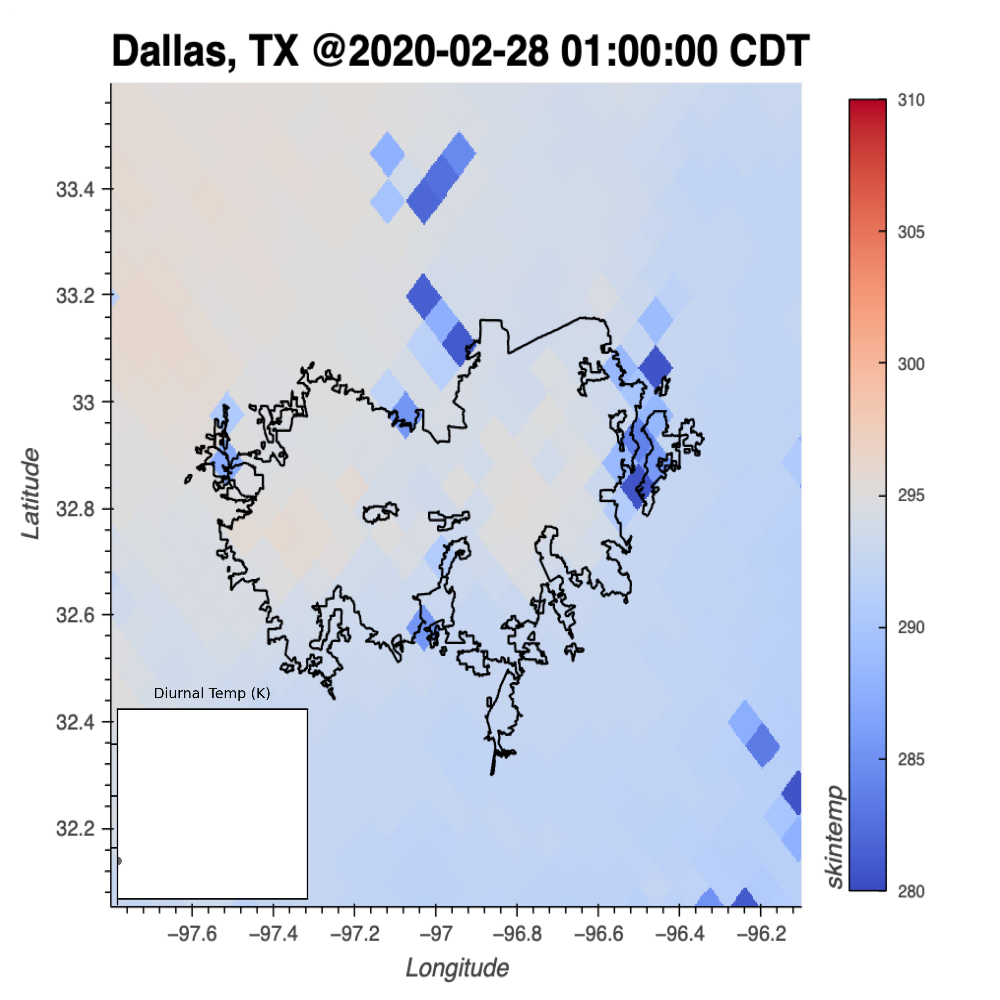

In [31]:
import matplotlib.animation as animation
from PIL import Image

lat_bounds, lon_bounds = dal_bounds
uxda_fine_subset = uxds_fine5_skintemp.subset.bounding_box(lon_bounds, lat_bounds)
shp = gpd.read_file("/glade/work/yifanc17/02_data/02_urban_1km_dataset/boundary_shp/USGS_TIGER_city/Dallas.shp")

image_files = [
    'dal_20200228_1am.png', 'dal_20200228_4am.png', 'dal_20200228_7am.png',
    'dal_20200228_10am.png', 'dal_20200228_1pm.png', 'dal_20200228_4pm.png',
    'dal_20200228_7pm.png', 'dal_20200228_10pm.png'
]

temps=[]
for time in ['2020-02-28T06:00:00','2020-02-28T09:00:00','2020-02-28T12:00:00',
            '2020-02-28T15:00:00','2020-02-28T18:00:00','2020-02-28T21:00:00',
            '2020-02-29T00:00:00','2020-02-29T03:00:00']:   
    value=average_temp_in_city(uxda_fine_subset.sel(time=time),shp)
    temps.append(value)

times = ['1am','4am','7am','10am','1pm','4pm','7pm','10pm']

fig, ax = plt.subplots(figsize=(10, 10), dpi=300)
img_handle = ax.imshow(np.zeros((10, 10, 3), dtype=np.uint8)) 
line_ax = fig.add_axes([0.21, 0.18, 0.15, 0.15]) 
line_plot, = line_ax.plot([], [], 'r-o', lw=2)

def update(i):
    img = np.array(Image.open(image_files[i]))
    img_handle.set_data(img)
    ax.axis('off') 

    line_ax.clear()
    line_ax.plot(times[:i+1], temps[:i+1], color='dimgray', marker='o', markersize=4, lw=2)
    line_ax.set_xlim(0, len(temps))
    line_ax.set_ylim(min(temps) - 1, max(temps) + 1)
    line_ax.set_title("Diurnal Temp (K)", fontsize=8)
    line_ax.set_xticklabels([])
    line_ax.set_yticklabels([])

    return img_handle, line_plot

ani = animation.FuncAnimation(fig, update, frames=len(image_files), blit=False)

ani.save("dal_diurnal_line_overlay.mov", fps=5, writer="ffmpeg",bitrate=8000)

## Bowen ratio

In [6]:
%%time
uxds_fine1_bowen=uxds_fine1.hfssd.sel(time='2020-02-29')/uxds_fine1.hflsd.sel(time='2020-02-29')

CPU times: user 2.5 s, sys: 2.48 s, total: 4.99 s
Wall time: 9.59 s


In [7]:
%%time
uxds_fine1_bowen2=uxds_fine1.hfssd.sel(time='2020-08-01')/uxds_fine1.hflsd.sel(time='2020-08-01')

CPU times: user 2.63 s, sys: 1.47 s, total: 4.1 s
Wall time: 7.73 s


In [8]:
uxds_fine1_bowen=uxds_fine1_bowen.where(np.isfinite(uxds_fine1_bowen))

In [9]:
uxds_fine1_bowen2=uxds_fine1_bowen2.where(np.isfinite(uxds_fine1_bowen2))

In [10]:
%%time
# denver CO
lat_bounds = (39.6-1, 39.9+1)
lon_bounds = (-105.1-1, -104.7+1)

uxda_fine_subset = uxds_fine1_bowen.subset.bounding_box(lon_bounds, lat_bounds)
#uxda_fine_subset = uxds_fine1.ts.sel(time='2020-02-29T03:00:00.000000000').subset.bounding_box(lon_bounds, lat_bounds)

CPU times: user 14min 15s, sys: 3min 50s, total: 18min 6s
Wall time: 43min 7s


In [11]:
%%time
# Chicago, IL
lat_bounds = (41.6-1, 42.1+1)
lon_bounds = (-88.0-1, -87.5+1)

uxda_fine_subset2 = uxds_fine1_bowen.subset.bounding_box(lon_bounds, lat_bounds)
#uxda_fine_subset2 = uxds_fine1.ts.sel(time='2020-02-29T03:00:00.000000000').subset.bounding_box(lon_bounds, lat_bounds)

CPU times: user 411 ms, sys: 0 ns, total: 411 ms
Wall time: 2.94 s


In [62]:
%%time
import geopandas as gpd
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import hvplot

hvplot.extension('bokeh')

shp = gpd.read_file("/glade/work/yifanc17/02_data/02_urban_1km_dataset/boundary_shp/USGS_TIGER_city/Chicago.shp")

heatmap=uxda_fine_subset.plot(
    backend='bokeh',
    cmap="viridis",
    title="MPAS_DYAMOND2 2020-02-29 T03:00:00",
    features=["coastline", "borders"]
)

boundary = shp.hvplot(geo=True,
    line_color='black',
    line_width=1.5,
    color='None',  
    alpha=1)


combined = (heatmap * boundary).opts(
    width=650,
    height=600,
)

combined

CPU times: user 309 ms, sys: 11 ms, total: 320 ms
Wall time: 344 ms


:Overlay
   .Image.I     :Image   [Longitude,Latitude]   (Longitude_Latitude skintemp)
   .Borders.I   :Feature   [Longitude,Latitude]
   .Coastline.I :Feature   [Longitude,Latitude]
   .Polygons.I  :Polygons   [Longitude,Latitude]

In [22]:
hvplot.extension('bokeh')

shp = gpd.read_file("/glade/work/yifanc17/02_data/02_urban_1km_dataset/boundary_shp/CHI/Chicago.shp")

heatmap=uxda_fine_subset2.plot(
    cmap='viridis',
    backend='bokeh',
    title="icon_d3hp003 2020-02-29",
    features=["coastline", "borders"],
    clim=(0,2)
)

boundary = shp.hvplot(geo=True,
    line_color='black',
    line_width=1.5,
    color='None',  
    alpha=1)


combined = (heatmap * boundary).opts(
    width=1000,
    height=600,
)

combined

:Overlay
   .Image.I     :Image   [Longitude,Latitude]   (Longitude_Latitude var)
   .Borders.I   :Feature   [Longitude,Latitude]
   .Coastline.I :Feature   [Longitude,Latitude]
   .Polygons.I  :Polygons   [Longitude,Latitude]